# Audio Style Transfer   

## Neural Style Transfer for Images

First proposed by Gatsy et al.\[1\], neural style transfer is an algorithm, initially targeting the image domain, that reproduces an input image with a new artistic style based on the provided style image as exemplified below.

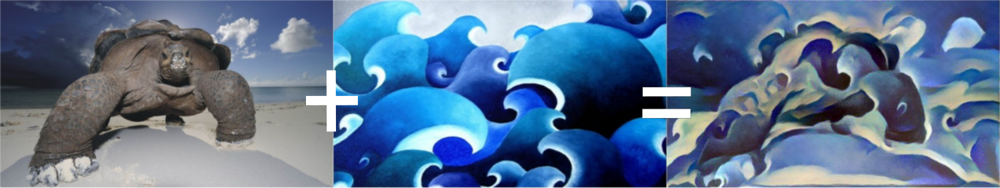
\[image taken from https://pytorch.org/tutorials/advanced/neural_style_tutorial.html \]

This neural style transfer algorithm \[1\] does not train any neural network, on the contrary, it is an optimization technique that modifies the **target** signal, which is initialized as white noise, to match the **content** input with the style inferred from the **style** signal.
It is based on a pre-trained convolutional neural network, VGG\[2\], which is trained on ImageNet for image classification task and is believed to encode more and more complex features throughout its layers. 
Convolutional neural networks are claimed to generalize well because they are able to capture the invariances and particular features defining different classes that are abstracted from background noise and other nuisances such that the intermediate layers can describe the content and the style of an image. 
Hence, the main objective of the neural style transfer is to match the style and content representations encoded by the pre-trained model at its intermediate layers.

In a nutshell, the target image is considered as a variable to be trained for, and the content and style losses are defined based on the target-content and target-style image pairs. The content loss is defined as the discrepancy between the activation layer $a_l(\cdot)$ of each image, i.e., $\mathcal{L}_{\text{content}} = \frac{1}{2}\sum_{ij} \left(a_l(\mathbf{C})_{ij} - \mathbf{T})_{ij}\right)^2$, where $\mathbf{C}, \mathbf{T}$ represent target and content images, respectively. On the other hand, the style loss is defined by the correlations between activations of the target and style images across different channels, which can be nicely described by a Gram matrix. The Gram matrix is simply calculated by using the flattened activations, such as $a_l(\mathbf{S})$ or $a_l(\mathbf{T})$ for each feature channel. The style loss is then computed as the discrepancy between the Gram matrix of the style image at layer $l$, $G_l(\mathbf{S})$, and the Gram matrix of the target image at the same layer $G_l(\mathbf{T})$ such that  $\mathcal{L}_{\text{style}(L)} = \frac{1}{N_l^2, M_l^2}\sum_{ij} \left(G_l(\mathbf{C})_{ij} - G_l(\mathbf{T})_{ij}\right)^2$, where $N_l, M_l$ denote number of feature channels and the dimension of flattened activations, respectively. In \[1\], the style loss is computed using multiple intermediate convolutional layers, and the totall loss is computed as a weighted sum of the content and style losses.


## Neural Style Transfer for Audio
One straightforward application of neural style transfer for audio is achieved in \[3\], where Eric *et al.* obtained the best results when they initialize the target as the content audio, and slowly modify it to match the style via aforementioned method of matching the Gram matrix. However, they compute the features over the Short Time Fourier Transform (STFT) spectograms of the target and style audio. As the target audio is initialized with the content, the loss function in this case only consists of the style loss.


## Jukebox
In this notebook, rather than operating on spectograms, we opt for using a pre-trained network for raw audio signals to bypass the need for mapping the spectogram back to audio signals, which involves ambiguities due to phase reconstruction. We rather use the encoded representations for computing the Gram matrix for neural style transfer, and either consider the modified input as our outcome, or decode the modified representation using the pre-trained network as an alternative. 

In particular, we use the autoencoder in Jukebox \[4\], which is a generative model that outputs audibly plausable audio clips in many different genres that maintain coherence with high fidelity up to multiple minutes. It first encodes raw audio files using a multi-scale VQ-VAE \[5\], and uses the resultant discrete codes as inputs to the autoregressive transformer for conditional or unconditional generation. We borrow the VQ-VAE of Jukebox which is 
trained on hours of raw audio and hence can successfully encode the raw audio signals to discrete codes.

The autoencoder of Jukebox is composed of three seperate VQ-VAE instances for different level of abstractions. Each level corresponds to a residual network consisting of noncausal 1-D dilated convolutions, interleaved with downsampling and upsampling 1-D convolutions to match different hop lengths. One key strategy they claim for high fidelity reconstructed audio is the additional spectral loss calculated over multiple STFT parameters. The autoencoders can compress 44 kHz audio by 8x, 32x and 128x at three different layers of abstraction, which are illustrated below.

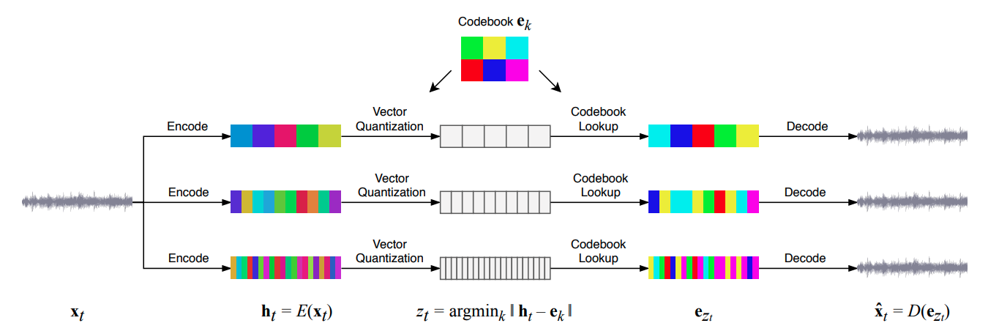
\[image taken from \[4\] \]



## Dependencies

We will mainly use the pytorch library in this notebook, and running it on a GPU is highly recommended

In [1]:
import os
import jukebox
import numpy as np 
import librosa
from IPython.display import display, Audio
from jukebox.make_models import make_vqvae, MODELS, make_model
from jukebox.hparams import Hyperparams, setup_hparams
from jukebox.utils.dist_utils import setup_dist_from_mpi
from jukebox.utils.torch_utils import empty_cache

from scipy.io import wavfile
from jukebox.vqvae.encdec import assert_shape
from jukebox.utils.audio_utils import audio_preprocess, audio_postprocess, load_audio, save_wav

import torch
from torch import nn
import torch.optim as optim

import matplotlib.pyplot as plt

rank, local_rank, device = setup_dist_from_mpi()

Using cuda True


Now, we will upload the Jukebox model "5b", which refers to the number of model parameters (5 billion). 

In [2]:
model = "5b" # or "1b_lyrics" or "5b_lyrics"  
vqvae, *priors = MODELS[model]
vqvae = make_vqvae(setup_hparams(vqvae, dict(sample_length = 1048576)), device)

# jukebox vqvae model: https://github.com/openai/jukebox/blob/master/jukebox/vqvae/vqvae.py
# encoders: vqvae.encoders, decoders: vqvae.decoders - list with lenght = # of levels
# vqvae.encode() returns a list elements of which are the latent variables (need to apply preprocessing
# alternatively, for the encoder
# xs = []
# for level in range(vqvae.levels):
#     encoder = vqvae.encoders[level]
#     x_out = encoder(x_in)
#     xs.append(x_out[-1])

Restored from /home/besbinar/.cache/jukebox/models/5b/vqvae.pth.tar
0: Loading vqvae in eval mode


Let's inspect one of the encoders:

In [3]:
print(vqvae.encoders[2])

Encoder(
  (level_blocks): ModuleList(
    (0): EncoderConvBlock(
      (model): Sequential(
        (0): Sequential(
          (0): Conv1d(1, 32, kernel_size=(4,), stride=(2,), padding=(1,))
          (1): Resnet1D(
            (model): Sequential(
              (0): ResConv1DBlock(
                (model): Sequential(
                  (0): ReLU()
                  (1): Conv1d(32, 32, kernel_size=(3,), stride=(1,), padding=(1,))
                  (2): ReLU()
                  (3): Conv1d(32, 32, kernel_size=(1,), stride=(1,))
                )
              )
              (1): ResConv1DBlock(
                (model): Sequential(
                  (0): ReLU()
                  (1): Conv1d(32, 32, kernel_size=(3,), stride=(1,), padding=(3,), dilation=(3,))
                  (2): ReLU()
                  (3): Conv1d(32, 32, kernel_size=(1,), stride=(1,))
                )
              )
              (2): ResConv1DBlock(
                (model): Sequential(
                  (0): ReLU

We can observe that the encoder with compression rate 128x is further composed of three convolutional encoder blocks. Let us see this number for each autoencoder, which we can use later to compute our Gram matrices.

In [4]:
for ae_id in range(3):
    print(f"The number of convolutional blocks in autoencoder{ae_id} is: {len(vqvae.encoders[ae_id].level_blocks)}")

The number of convolutional blocks in autoencoder0 is: 1
The number of convolutional blocks in autoencoder1 is: 2
The number of convolutional blocks in autoencoder2 is: 3


## Reconstruction at different layers of VQ-VAE w/o quantization

We first investigate the effect of quantization in VQ-VAE for reconstruction. We first read and play a sample audio:

In [5]:
# sample data
sample_audio, sample_audio_sf = librosa.load("sample_data/alpha.wav", sr=44100)
print(sample_audio_sf)
Audio(sample_audio, rate=sample_audio_sf)

44100


We then encode-decode the input audio for all three autoencoders, and play the reconstructed outcome using the routine of the VQ-VAEs in evaluation mode

In [6]:
max_duration = 10  # in seconds
duration = min(max_duration, len(sample_audio)//sample_audio_sf)
x = sample_audio[ :duration*sample_audio_sf, ...].astype(float)
if len(x.shape) == 1:
    x = x[:, None]
x_tensor = torch.tensor(x[None,...]).cuda()  # the model expects a batched input

hps = Hyperparams()
hps.sr = 44100
hps.aug_blend = False  # that is the default

x_tensor = audio_preprocess(x_tensor, hps)
x_in = vqvae.preprocess(x_tensor)

xs = []
for level in range(vqvae.levels):
    encoder = vqvae.encoders[level]
    x_out = encoder(x_in)
    xs.append(x_out[-1])

zs, xs_quantised, _, _ = vqvae.bottleneck(xs)

x_outs = []
x_outs_nonquantised = []
for level in range(vqvae.levels):
    decoder = vqvae.decoders[level]
    
    x_out = decoder(xs_quantised[level:level+1], all_levels=False)
    x_outs.append(x_out)
    
    x_out = decoder(xs[level:level+1], all_levels=False)
    x_outs_nonquantised.append(x_out)

for level in range(vqvae.levels):
    x_outs[level] = vqvae.postprocess(x_outs[level])
    # x_out[level] = audio_postprocess(x_out[level], hps)  # because: def audio_postprocess(x, hps): return x
    x_outs_nonquantised[level] = vqvae.postprocess(x_outs_nonquantised[level])

### decoded from quantized codes - as in the original work

In [7]:
# Lowest compression - 8x
print("RECONSTRUCTED AUDIO WITH QUANTIZED CODES")
print("Level 0 - lowest compression (8x)")
display(Audio(x_outs[0].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

# Middle compression - 32x
print("Level 1 - middle compression (32x)")
display(Audio(x_outs[1].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

# Highest compression - 128
print("Level 2 - highest compression (128x)")
display(Audio(x_outs[2].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

RECONSTRUCTED AUDIO WITH QUANTIZED CODES
Level 0 - lowest compression (8x)


Level 1 - middle compression (32x)


Level 2 - highest compression (128x)


### decoded from non-quantized codes: almost the same output

In [8]:
print("RECONSTRUCTED AUDIO WITH NON-QUANTIZED CODES")

# Lowest compression for non-quantized codes- 8x
print("Level 0 - lowest compression (8x)")
display(Audio(x_outs_nonquantised[0].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

# Middle compression for non-quantized codes- 32x
print("Level 1 - middle compression (32x)")
display(Audio(x_outs_nonquantised[1].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

# Highest compression for non-quantized codes- 128
print("Level 2 - highest compression (128x)")
display(Audio(x_outs_nonquantised[2].detach().squeeze().cpu().numpy(), rate=sample_audio_sf))

RECONSTRUCTED AUDIO WITH NON-QUANTIZED CODES
Level 0 - lowest compression (8x)


Level 1 - middle compression (32x)


Level 2 - highest compression (128x)


We can observe that despite the high compression rates, the audio is still reconstructed with succsess, and the quantization does not play an extremely crucial role, i.e., audilbly noticable, for the reconstruction.

# Neural Audio Style Transfer

## Utility functions 

In [3]:
# preprocessing
def prepare_data(content_audio_name, style_audio_name, data_dir="sample_data", max_dur=10):
    content_dir = os.path.join(data_dir, content_audio_name)
    style_dir = os.path.join(data_dir, style_audio_name)
    
    print("The content audio:")
    display(Audio(content_dir))
    
    print("The style audio:")
    display(Audio(style_dir))

    style_clip, style_sf = librosa.load(style_dir, sr=44100, duration=max_dur)
    if len(style_clip.shape) == 1:
        style_clip = style_clip[:, None].astype(float)

    content_clip, content_sf = librosa.load(content_dir, sr=44100, duration=max_dur)
    if len(content_clip.shape) == 1:
        content_clip = content_clip[:, None].astype(float)

    assert style_sf == content_sf
    duration = min(max_dur, len(content_clip)//44100)
    duration = min(duration, len(style_clip)//44100)

    hps = Hyperparams()
    hps.sr = 44100
    hps.aug_blend = False  # that is the default

    style_clip = style_clip[:duration*style_sf,...]
    style_tensor = torch.tensor(style_clip[None,...]).cuda()  # additional batch dimension
    style_tensor = audio_preprocess(style_tensor, hps)  # normalize to [-1, 1]

    content_clip = content_clip[:duration*content_sf,...]
    content_tensor = torch.tensor(content_clip[None,...]).cuda()
    content_tensor = audio_preprocess(content_tensor, hps)
    
    return content_tensor, style_tensor


def audio_spectrum(filename, data_dir="sample_data", max_dur=10, N_FFT=2048, plot=True):
    x, fs = librosa.load(os.path.join(data_dir, filename), duration=max_dur)
    S = librosa.stft(x, N_FFT)
    p = np.angle(S)
    S = np.log1p(np.abs(S))  
    
    return S


def plot_spectrums(
    content_audio_name, 
    style_audio_name, 
    model_name="grammatrix_alllevels", 
    level=2, 
    crop_at=500
):
    
    content_audio = audio_spectrum(content_audio_name)
    style_audio = audio_spectrum(style_audio_name)
    
    if level is not None:
        level_suffix = f"_level{level}"
    else:
        level_suffix = ""
        
    filename = f"{content_audio_name[:-4]}_{style_audio_name[:-4]}_{model_name}"

    output_audio1 = audio_spectrum(f"{filename}_input.wav")
    output_audio2 = audio_spectrum(f"{filename}_decoded{level_suffix}.wav")
    output_audio3 = audio_spectrum(f"{filename}_decoded_noquant{level_suffix}.wav")

    plt.figure(figsize=(16,12))
    plt.subplot(2,3,1)
    plt.title('Content')
    plt.imshow(content_audio[:crop_at,:crop_at])
    plt.subplot(2,3,2)
    plt.title('Style')
    plt.imshow(style_audio[:crop_at,:crop_at])
    plt.subplot(2,3,4)
    plt.title('Result 1 - Modified Input')
    plt.imshow(output_audio1[:crop_at,:crop_at])
    plt.subplot(2,3,5)
    plt.title('Result 2 - Decoded Code w/ Quantization')
    plt.imshow(output_audio2[:crop_at,:crop_at])
    plt.subplot(2,3,6)
    plt.title('Result 3 - Decoded Code w/o Quantization')
    plt.imshow(output_audio3[:crop_at,:crop_at])
    plt.show()
    plt.show()

## Audio style transfer using the Gram matrix of a particular autoencoder

In [21]:
class ContentLoss(nn.Module):
    def __init__(self, target_feature):
        super(ContentLoss, self).__init__()
        self.target = target_feature.detach()

    def forward(self, input_features):
        self.loss = nn.functional.mse_loss(input_features, self.target)
        return input_features

    
def gram_matrix(x, window_size=128):
    N, C, L = x.size()
    assert N == 1  # one-shot transfer, no batching assumed
    
    features = x.permute(2,1,0)    # we consider time step as the batch dimension to average over
    G = torch.matmul(features, features.permute(0,2,1))  # compute the gram product
    
    return G.div(C**2)


class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input_features):
        G = gram_matrix(input_features)
        self.loss = nn.functional.mse_loss(G, self.target)
        return input_features
    
    
def get_input_optimizer(input_audio):
    optimizer = optim.LBFGS([input_audio])
    return optimizer


class audio_style_transfer(nn.Module):
    def __init__(
        self, 
        vqvae,
        jukebox_level,
        style_input,
        content_input,
    ):
        super().__init__()

        # set up Jukebox modules
        self.vqvae = vqvae
        self.output_level = jukebox_level

        # process the input to get VQVAE embedding (before quantization)
        style_input = self.vqvae.preprocess(style_input)
        content_input = self.vqvae.preprocess(content_input)
        
        style_codes = []
        self.style_losses = []
        for level in range(self.vqvae.levels):
            encoder = self.vqvae.encoders[level]
            
            feature_maps = encoder(style_input)
            
            if level == jukebox_level:
                for idx,feature_map in enumerate(feature_maps):
                    # initialize the loss with the Gram matrix of the feature map(s) of the selected autoencoder
                    style_loss = StyleLoss(feature_map)
                    self.add_module(f"style_loss_ae{level}_fm{idx}", style_loss)
                    self.style_losses.append(style_loss)
                    
                # initialize the content loss
                content_feature_maps = encoder(content_input)
                self.content_loss = ContentLoss(content_feature_maps[-1])
                
            style_codes.append(feature_maps[-1])
        
        
    def forward(self, input_audio):
        
        input_audio = self.vqvae.preprocess(input_audio)
        
        target_codes = []
        for level in range(self.vqvae.levels):
            encoder = self.vqvae.encoders[level]
            
            feature_maps = encoder(input_audio)
            if level == self.output_level:
                
                for idx,feature_map in enumerate(feature_maps):
                    style_loss = getattr(self, f"style_loss_ae{level}_fm{idx}")(feature_map)
                    
                self.content_loss(feature_maps[-1])
                
            target_codes.append(feature_maps[-1])
            
        # decode the embedding for the alternate output
        target_embed = target_codes[self.output_level:self.output_level+1]
        
        _, target_codes_q, _, _ = self.vqvae.bottleneck(target_codes)
        target_embed_q = target_codes_q[self.output_level:self.output_level+1]
        
        decoder = self.vqvae.decoders[self.output_level]
        decoded_content_1 = decoder(target_embed, all_levels=False)
        decoded_content_1 = self.vqvae.postprocess(decoded_content_1)
        
        decoded_content_2 = decoder(target_embed_q, all_levels=False)
        decoded_content_2 = self.vqvae.postprocess(decoded_content_2)

        return decoded_content_1, decoded_content_2

    
def run_style_loss(
    jukebox_module, 
    jukebox_level, 
    content_audio, 
    style_audio, 
    content_name, 
    style_name, 
    content_weight=1e-3,
    style_weight=10.0,
    num_iters=200, 
    sf=44100
):
    
    input_audio = content_audio.clone()
    input_audio.requires_grad_(True)
    
    model = audio_style_transfer(jukebox_module, jukebox_level, style_audio, content_audio)
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_audio)
    
    print('Optimizing..')
    run = [0]
    while run[0] <= num_iters:

        def closure():
            optimizer.zero_grad()
            _, _ = model(input_audio)
            
            style_score = 0
            for sl in model.style_losses:
                style_score += sl.loss
            total_loss = style_score.mean() + content_weight * model.content_loss.loss.mean()
            total_loss.backward()

            if run[0] % 10 == 0:
                print(f"Iteration {run}, loss value: {total_loss.item()}")
            run[0] += 1

            return total_loss

        optimizer.step(closure)
        
    
    output_audio_1, output_audio_2 = model(input_audio)
        
    wavfile.write(
        f"sample_data/{content_name}_{style_name}_grammatrix_onlylevel{model.output_level}_input.wav", 
        rate=sf, 
        data=input_audio.detach().squeeze().cpu().numpy()
    )
    wavfile.write(
        f"sample_data/{content_name}_{style_name}_grammatrix_onlylevel{model.output_level}_decoded_noquant.wav", 
        rate=sf, 
        data=output_audio_1.detach().squeeze().cpu().numpy()
    )
    wavfile.write(
        f"sample_data/{content_name}_{style_name}_grammatrix_onlylevel{model.output_level}_decoded.wav", 
        rate=sf, 
        data=output_audio_2.detach().squeeze().cpu().numpy()
    )

### read and process data

In [5]:
content_audio_name = "flute.mp3"
style_audio_name = "tremolo_strings.mp3"

content_tensor, style_tensor = prepare_data(content_audio_name, style_audio_name)

The content audio:


The style audio:


/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


### only level 0 autoencoder

In [23]:
run_style_loss(
    vqvae, 
    0, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=40,
    content_weight=0.0,
)

Optimizing..
Iteration [0], loss value: 0.011607799679040909
Iteration [10], loss value: 0.010536388494074345
Iteration [20], loss value: 0.008518834598362446
Iteration [30], loss value: 0.007730184122920036
Iteration [40], loss value: 0.007078276015818119
Iteration [50], loss value: 0.006516098044812679


In [ ]:
print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel0_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel0_decoded_noquant.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel0_decoded.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_onlylevel0", level=None)

### only level 1 autoencoder

In [25]:
run_style_loss(
    vqvae, 
    1, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=50,
    content_weight=0.0,
)

Optimizing..
Iteration [0], loss value: 0.0013633576454594731
Iteration [10], loss value: 0.0013633576454594731
Iteration [20], loss value: 0.0013633576454594731
Iteration [30], loss value: 0.0013633576454594731
Iteration [40], loss value: 0.0013633576454594731
Iteration [50], loss value: 0.0013633576454594731


In [ ]:
print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel1_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel1_decoded_noquant.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel1_decoded.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_onlylevel0", level=None)

### only level 2 autoencoder

In [27]:
run_style_loss(
    vqvae, 
    2, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=20,
    content_weight=0.0,
)

Optimizing..
Iteration [0], loss value: 0.0004475887108128518
Iteration [10], loss value: 0.0004475887108128518
Iteration [20], loss value: 0.0004475887108128518


In [ ]:
print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel2_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel2_decoded_noquant.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_onlylevel2_decoded.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_onlylevel0", level=None)

## Audio style transfer using the Gram matrix of all autoencoders

In [29]:
def gram_matrix(x):
    N, C, L = x.size()
    assert N == 1
    
    features = x.permute(2,1,0)    # we consider time step as the batch dimension to average over
    G = torch.matmul(features, features.permute(0,2,1))  # compute the gram product

    return G.div(C**2)

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input_features):
        G = gram_matrix(input_features)
        self.loss = nn.functional.mse_loss(G, self.target)
        return input
    
def get_input_optimizer(input_audio):
    optimizer = optim.LBFGS([input_audio])
    return optimizer


class audio_style_transfer_all_levels(nn.Module):
    def __init__(
        self, 
        vqvae,
        style_input,
    ):
        super().__init__()

        # set up Jukebox modules
        self.vqvae = vqvae
        self.losses = []

        # process the style input to get VQVAE embedding (before quantization)
        style_input = self.vqvae.preprocess(style_input)
        for level in range(self.vqvae.levels):
            encoder = self.vqvae.encoders[level]
            feature_maps = encoder(style_input)
            for idx,feature_map in enumerate(feature_maps):
                # initialize the loss with the Gram matrix of the feature map(s) of the selected autoencoder
                style_loss = StyleLoss(feature_map)
                self.add_module(f"style_loss_ae{level}_fm{idx}", style_loss)
                self.losses.append(style_loss)
            
        
    def forward(self, content_input):
        
        content_input = self.vqvae.preprocess(content_input)
        
        content_codes = []
        for level in range(self.vqvae.levels):
            encoder = self.vqvae.encoders[level]
            content_feature_maps = encoder(content_input)
            for idx,feature_map in enumerate(content_feature_maps):
                style_loss = StyleLoss(feature_map)
                _ = getattr(self, f"style_loss_ae{level}_fm{idx}")(feature_map)
                
            content_codes.append(content_feature_maps[-1])
        
        _, content_codes_q, _, _ = self.vqvae.bottleneck(content_codes)
        
        outputs = {}
        for level in range(vqvae.levels):
            decoder = self.vqvae.decoders[level]

            x_out = decoder(content_codes_q[level:level+1], all_levels=False)
            outputs[f"quantization_level{level}"] = self.vqvae.postprocess(x_out)

            x_out_nq = decoder(content_codes[level:level+1], all_levels=False)
            outputs[f"noquantization_level{level}"] = self.vqvae.postprocess(x_out_nq)
        
        return outputs

    
def run_style_loss_alllevels(
    jukebox_module, 
    content_audio, 
    style_audio, 
    content_name,
    style_name,
    num_iters=100, 
    sf=44100, 
    output_levels=[2]
):
    
    print(f"Style clip shape: {style_audio.shape}")
    print(f"Content clip shape: {content_audio.shape}")

    input_audio = content_audio.clone()
    input_audio.requires_grad_(True)
    
    model = audio_style_transfer_all_levels(jukebox_module, style_audio)
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_audio)
    
    print('Optimizing..')
    run = [0]
    while run[0] <= num_iters:

        def closure():

            optimizer.zero_grad()
            outputs = model(input_audio)
            
            loss = 0.
            for l in model.losses:
                loss += l.loss
            loss.backward()

            if run[0] % 10 == 0:
                print("run {}:".format(run))
                print(f"Iteration {run}, loss value: {loss.item()}")
            run[0] += 1

            return loss

        optimizer.step(closure)
        
    
    outputs = model(input_audio)
    
    wavfile.write(
        f"sample_data/{content_name}_{style_name}_grammatrix_alllevels_input.wav", 
        rate=sf, 
        data=input_audio.detach().squeeze().cpu().numpy()
    )
    
    for level in output_levels:
        wavfile.write(
            f"sample_data/{content_name}_{style_name}_grammatrix_alllevels_decoded_level{level}.wav", 
            rate=sf, 
            data=outputs[f"quantization_level{level}"].detach().squeeze().cpu().numpy()
        )
        wavfile.write(
            f"sample_data/{content_name}_{style_name}_grammatrix_alllevels_decoded_noquant_level{level}.wav", 
            rate=sf, 
            data=outputs[f"noquantization_level{level}"].detach().squeeze().cpu().numpy()
        )
        

### all level autoencoders

In [34]:
run_style_loss_alllevels(
    vqvae, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=90
)

Style clip shape: torch.Size([1, 352800, 1])
Content clip shape: torch.Size([1, 352800, 1])
Optimizing..
run [0]:
Iteration [0], loss value: 0.013418745249509811
run [10]:
Iteration [10], loss value: 0.012061303481459618
run [20]:
Iteration [20], loss value: 0.010457966476678848
run [30]:
Iteration [30], loss value: 0.00947692058980465
run [40]:
Iteration [40], loss value: 0.008812552317976952
run [50]:
Iteration [50], loss value: 0.008538151159882545
run [60]:
Iteration [60], loss value: 0.007761674001812935
run [70]:
Iteration [70], loss value: 0.02223873883485794
run [80]:
Iteration [80], loss value: 0.0070392596535384655
run [90]:
Iteration [90], loss value: 0.006882993970066309


Modified input


Decoded input


Decoded input w/o quantization


/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: Pass n_fft=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: Pass n_fft=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error


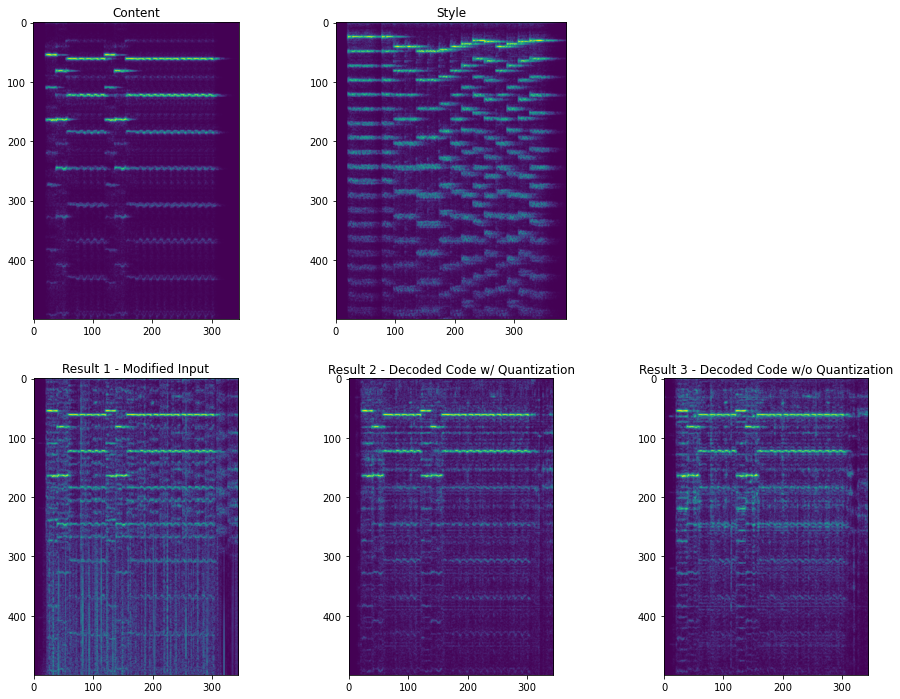

In [35]:
print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_level2.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_noquant_level2.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_alllevels", level=2)

### different inputs

The content audio:


The style audio:


/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


Style clip shape: torch.Size([1, 220500, 1])
Content clip shape: torch.Size([1, 220500, 1])
Optimizing..
run [0]:
Iteration [0], loss value: 0.017499910667538643
run [10]:
Iteration [10], loss value: 0.016097422689199448
run [20]:
Iteration [20], loss value: 0.012988362461328506
run [30]:
Iteration [30], loss value: 0.011767291463911533
run [40]:
Iteration [40], loss value: 0.011329320259392262
run [50]:
Iteration [50], loss value: 0.010440630838274956
run [60]:
Iteration [60], loss value: 0.010394948534667492
run [70]:
Iteration [70], loss value: 0.010086067020893097
run [80]:
Iteration [80], loss value: 0.009481803514063358
run [90]:
Iteration [90], loss value: 0.009180218912661076
Modified input


Decoded input


Decoded input w/o quantization


/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: Pass n_fft=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)
/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: Pass n_fft=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error


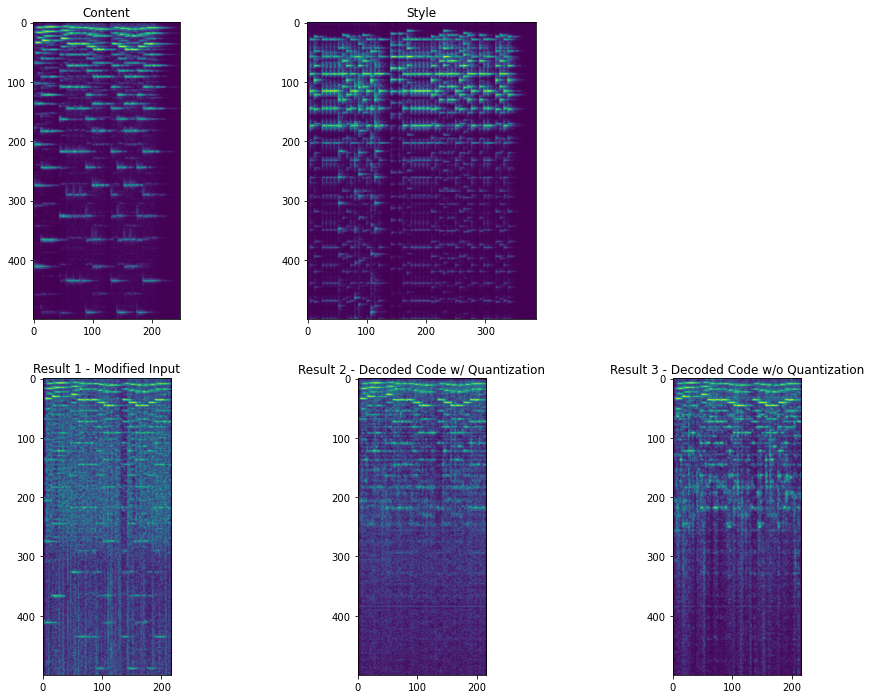

In [38]:
content_audio_name = "church_organ.mp3"
style_audio_name = "banjo.mp3"

content_tensor, style_tensor = prepare_data(content_audio_name, style_audio_name)

run_style_loss_alllevels(
    vqvae, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=90
)

print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_level2.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_noquant_level2.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_alllevels", level=2)

In [ ]:
content_audio_name = "guitar_moonlight.wav"
style_audio_name = "piano_moonlight.wav"

content_tensor, style_tensor = prepare_data(content_audio_name, style_audio_name)

run_style_loss_alllevels(
    vqvae, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=90
)

print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_level2.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_noquant_level2.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_alllevels", level=2)

The content audio:


The style audio:


Style clip shape: torch.Size([1, 88200, 1])
Content clip shape: torch.Size([1, 88200, 1])
Optimizing..
run [0]:
Iteration [0], loss value: 0.0010739726712927222
run [10]:
Iteration [10], loss value: 0.0008694804855622351
run [20]:
Iteration [20], loss value: 0.0004388511588331312
run [30]:
Iteration [30], loss value: 0.00035439778002910316
run [40]:
Iteration [40], loss value: 0.00034990633139386773
run [50]:
Iteration [50], loss value: 0.00033655576407909393
run [60]:
Iteration [60], loss value: 0.0002992106892634183
run [70]:
Iteration [70], loss value: 0.0002961684367619455
run [80]:
Iteration [80], loss value: 0.00028773178928531706
run [90]:
Iteration [90], loss value: 1.6533962488174438
run [100]:
Iteration [100], loss value: 0.0002975233073811978
run [110]:
Iteration [110], loss value: 0.0002663965569809079
Modified input


Decoded input


Decoded input w/o quantization


/home/besbinar/.conda/envs/com418/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: Pass n_fft=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error


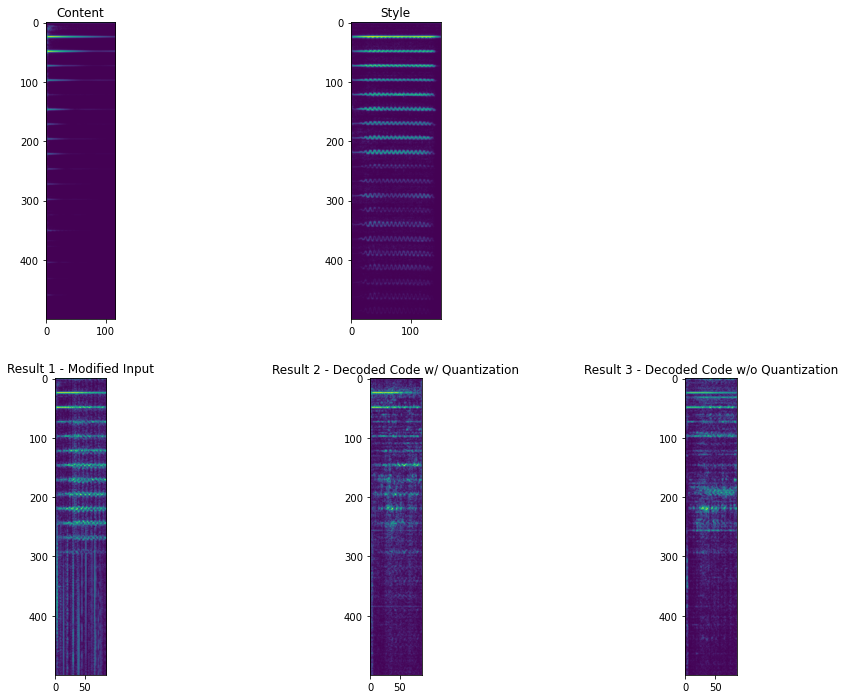

In [43]:
content_audio_name = "piano-C4.wav"
style_audio_name = "violin-C4.wav"

content_tensor, style_tensor = prepare_data(content_audio_name, style_audio_name)

run_style_loss_alllevels(
    vqvae, 
    content_tensor, 
    style_tensor, 
    content_audio_name[:-4], 
    style_audio_name[:-4], 
    num_iters=110
)

print("Modified input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_input.wav"))

print("Decoded input")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_level2.wav"))

print("Decoded input w/o quantization")
display(Audio(f"sample_data/{content_audio_name[:-4]}_{style_audio_name[:-4]}_grammatrix_alllevels_decoded_noquant_level2.wav"))

plot_spectrums(content_audio_name, style_audio_name, "grammatrix_alllevels", level=2)

## References
\[1\] Gatys, Leon A., Alexander S. Ecker, and Matthias Bethge. "A neural algorithm of artistic style." arXiv preprint arXiv:1508.06576 (2015).

\[2\] Simonyan, Karen, and Andrew Zisserman. "Very deep convolutional networks for large-scale image recognition." arXiv preprint arXiv:1409.1556 (2014).

\[3\] Grinstein, Eric, Ngoc QK Duong, Alexey Ozerov, and Patrick Pérez. "Audio style transfer." In 2018 IEEE international conference on acoustics, speech and signal processing (ICASSP), pp. 586-590. IEEE, 2018.

\[4\] Dhariwal, Prafulla, Heewoo Jun, Christine Payne, Jong Wook Kim, Alec Radford, and Ilya Sutskever. "Jukebox: A generative model for music." arXiv preprint arXiv:2005.00341 (2020).

\[5\] Van Den Oord, Aaron, and Oriol Vinyals. "Neural discrete representation learning." Advances in neural information processing systems 30 (2017).